# <center> PREDICTING GOLD PRICE

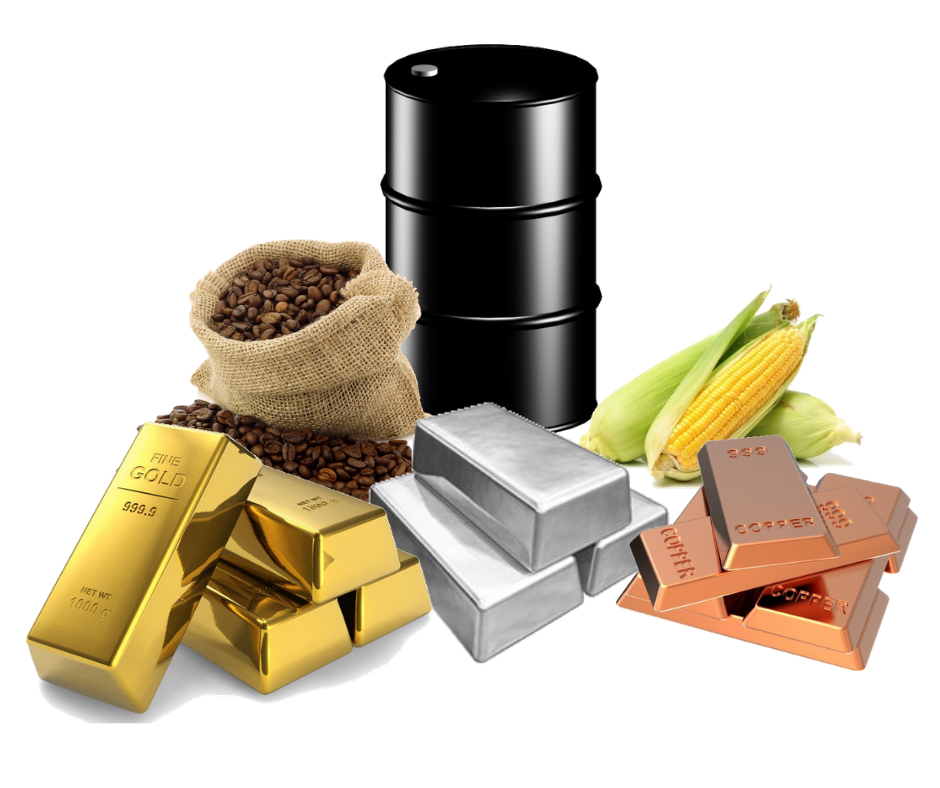

# Importing necessary libraries

In [8]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score,mean_absolute_error, mean_squared_error
from sklearn.preprocessing import LabelEncoder, RobustScaler
from sklearn.linear_model import LinearRegression,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor,AdaBoostRegressor
from sklearn.svm import LinearSVR
from sklearn.model_selection import cross_val_score

In [9]:
df=pd.read_csv("commodity_futures.csv")

In [10]:
df

,Date,NATURAL GAS,GOLD,WTI CRUDE,BRENT CRUDE,SOYBEANS,CORN,COPPER,SILVER,LOW SULPHUR GAS OIL,...,ZINC,ULS DIESEL,NICKEL,WHEAT,SUGAR,GASOLINE,COFFEE,LEAN HOGS,HRW WHEAT,COTTON
0,2000-01-03,NaN,NaN,NaN,NaN,456.50,200.75,NaN,NaN,NaN,...,1237.50,NaN,8446.0,247.50,6.10,NaN,116.50,55.975,274.25,51.07
1,2000-01-04,2.176,283.7,25.55,24.39,464.25,203.00,0.8480,5.375,213.50,...,1215.00,67.78,8314.0,247.25,5.77,NaN,116.25,55.625,274.00,50.73
2,2000-01-05,2.168,282.1,24.91,23.73,469.25,203.00,0.8565,5.210,213.00,...,1209.25,66.55,8307.0,249.75,5.81,NaN,118.60,55.075,276.25,51.56
3,2000-01-06,2.196,282.4,24.78,23.62,468.00,203.75,0.8530,5.167,211.25,...,1212.00,66.28,8252.0,248.50,5.77,NaN,116.85,55.175,275.00,52.08
4,2000-01-07,2.173,282.9,24.22,23.09,471.50,207.00,0.8540,5.195,205.25,...,1209.25,64.75,8174.0,251.75,5.84,NaN,114.15,55.625,277.75,53.96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5903,2022-11-14,5.933,1776.9,85.87,93.14,1441.75,657.25,3.8335,22.113,991.75,...,3154.00,354.40,28767.0,818.50,19.83,252.85,166.20,84.875,956.25,85.28
5904,2022-11-15,6.034,1776.8,86.92,93.86,1457.25,666.75,3.8200,21.518,990.25,...,3125.00,364.13,30176.0,828.25,20.29,251.61,156.75,85.325,963.00,88.74
5905,2022-11-16,6.200,1775.8,85.59,92.86,1429.25,665.25,3.7735,21.524,991.75,...,3061.50,361.36,27441.0,817.50,20.27,250.80,155.45,85.575,955.50,88.44
5906,2022-11-17,6.369,1763.0,81.64,89.78,1417.00,667.50,3.6880,20.975,956.00,...,2988.00,352.48,24934.0,806.75,19.73,245.47,152.70,84.975,938.00,87.04


# Exploratory Data Analysis

In [11]:
df.head()

,Date,NATURAL GAS,GOLD,WTI CRUDE,BRENT CRUDE,SOYBEANS,CORN,COPPER,SILVER,LOW SULPHUR GAS OIL,...,ZINC,ULS DIESEL,NICKEL,WHEAT,SUGAR,GASOLINE,COFFEE,LEAN HOGS,HRW WHEAT,COTTON
0,2000-01-03,NaN,NaN,NaN,NaN,456.50,200.75,NaN,NaN,NaN,...,1237.50,NaN,8446.0,247.50,6.10,NaN,116.50,55.975,274.25,51.07
1,2000-01-04,2.176,283.7,25.55,24.39,464.25,203.00,0.8480,5.375,213.50,...,1215.00,67.78,8314.0,247.25,5.77,NaN,116.25,55.625,274.00,50.73
2,2000-01-05,2.168,282.1,24.91,23.73,469.25,203.00,0.8565,5.210,213.00,...,1209.25,66.55,8307.0,249.75,5.81,NaN,118.60,55.075,276.25,51.56
3,2000-01-06,2.196,282.4,24.78,23.62,468.00,203.75,0.8530,5.167,211.25,...,1212.00,66.28,8252.0,248.50,5.77,NaN,116.85,55.175,275.00,52.08
4,2000-01-07,2.173,282.9,24.22,23.09,471.50,207.00,0.8540,5.195,205.25,...,1209.25,64.75,8174.0,251.75,5.84,NaN,114.15,55.625,277.75,53.96


In [12]:
df.tail()

,Date,NATURAL GAS,GOLD,WTI CRUDE,BRENT CRUDE,SOYBEANS,CORN,COPPER,SILVER,LOW SULPHUR GAS OIL,...,ZINC,ULS DIESEL,NICKEL,WHEAT,SUGAR,GASOLINE,COFFEE,LEAN HOGS,HRW WHEAT,COTTON
5903,2022-11-14,5.933,1776.9,85.87,93.14,1441.75,657.25,3.8335,22.113,991.75,...,3154.0,354.40,28767.0,818.50,19.83,252.85,166.20,84.875,956.25,85.28
5904,2022-11-15,6.034,1776.8,86.92,93.86,1457.25,666.75,3.8200,21.518,990.25,...,3125.0,364.13,30176.0,828.25,20.29,251.61,156.75,85.325,963.00,88.74
5905,2022-11-16,6.200,1775.8,85.59,92.86,1429.25,665.25,3.7735,21.524,991.75,...,3061.5,361.36,27441.0,817.50,20.27,250.80,155.45,85.575,955.50,88.44
5906,2022-11-17,6.369,1763.0,81.64,89.78,1417.00,667.50,3.6880,20.975,956.00,...,2988.0,352.48,24934.0,806.75,19.73,245.47,152.70,84.975,938.00,87.04
5907,2022-11-18,6.355,1759.7,79.46,87.42,1429.25,670.75,3.6655,21.145,947.50,...,2988.0,348.36,24934.0,809.75,20.03,241.16,152.50,84.075,939.00,85.85


In [13]:
df.sample()

,Date,NATURAL GAS,GOLD,WTI CRUDE,BRENT CRUDE,SOYBEANS,CORN,COPPER,SILVER,LOW SULPHUR GAS OIL,...,ZINC,ULS DIESEL,NICKEL,WHEAT,SUGAR,GASOLINE,COFFEE,LEAN HOGS,HRW WHEAT,COTTON
3597,2013-12-10,4.237,1262.4,98.51,109.38,1338.25,427.5,3.3015,20.256,928.0,...,1945.75,301.73,13874.0,629.5,16.62,268.29,109.65,80.825,694.5,80.69


In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5908 entries, 0 to 5907
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Date                 5908 non-null   object 
 1   NATURAL GAS          5907 non-null   float64
 2   GOLD                 5907 non-null   float64
 3   WTI CRUDE            5907 non-null   float64
 4   BRENT CRUDE          5907 non-null   float64
 5   SOYBEANS             5908 non-null   float64
 6   CORN                 5908 non-null   float64
 7   COPPER               5907 non-null   float64
 8   SILVER               5907 non-null   float64
 9   LOW SULPHUR GAS OIL  5907 non-null   float64
 10  LIVE CATTLE          5908 non-null   float64
 11  SOYBEAN OIL          5908 non-null   float64
 12  ALUMINIUM            5907 non-null   float64
 13  SOYBEAN MEAL         5908 non-null   float64
 14  ZINC                 5908 non-null   float64
 15  ULS DIESEL           5907 non-null   f

In [76]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
NATURAL GAS,4777.0,4.100492,1.747344,1.482,2.7720,3.591,5.231,9.9010
GOLD,4777.0,989.953758,512.193737,255.100,413.6000,1159.700,1320.600,2051.5000
WTI CRUDE,4777.0,56.442832,23.574959,10.010,36.4800,52.930,72.130,126.7700
BRENT CRUDE,4777.0,59.126948,26.917476,17.680,34.5000,56.430,74.530,127.1000
SOYBEANS,4777.0,910.456824,310.517584,418.000,601.5000,917.500,1047.500,1771.0000
CORN,4777.0,362.030772,139.311740,174.750,236.7500,357.750,398.500,831.2500
COPPER,4777.0,2.345734,1.066229,0.606,1.3085,2.624,3.177,4.7785
SILVER,4777.0,14.440301,7.585458,4.028,6.7300,15.348,18.078,37.1400
LOW SULPHUR GAS OIL,4777.0,517.556259,230.265724,148.500,315.0000,511.750,638.500,1192.5000
LIVE CATTLE,4777.0,102.405579,24.571994,59.400,82.5250,99.150,121.300,171.0000


In [16]:
df.drop(columns="Date",inplace=True)

In [17]:
df.isnull().mean()*100

NATURAL GAS             0.016926
GOLD                    0.016926
WTI CRUDE               0.016926
BRENT CRUDE             0.016926
SOYBEANS                0.000000
CORN                    0.000000
COPPER                  0.016926
SILVER                  0.016926
LOW SULPHUR GAS OIL     0.016926
LIVE CATTLE             0.000000
SOYBEAN OIL             0.000000
ALUMINIUM               0.016926
SOYBEAN MEAL            0.000000
ZINC                    0.000000
ULS DIESEL              0.016926
NICKEL                  0.000000
WHEAT                   0.000000
SUGAR                   0.000000
GASOLINE               25.101557
COFFEE                  0.000000
LEAN HOGS               0.000000
HRW WHEAT               0.000000
COTTON                  0.000000
dtype: float64

In [23]:
df.drop(columns='GASOLINE',inplace=True)

# Droping null values

In [24]:
df.dropna(inplace=True)


In [28]:
df.duplicated().sum()

3

In [29]:
df.drop_duplicates(inplace=True)

In [30]:
df.shape

(5904, 22)

# UNIVARIATE ANALYSIS

# Histogram

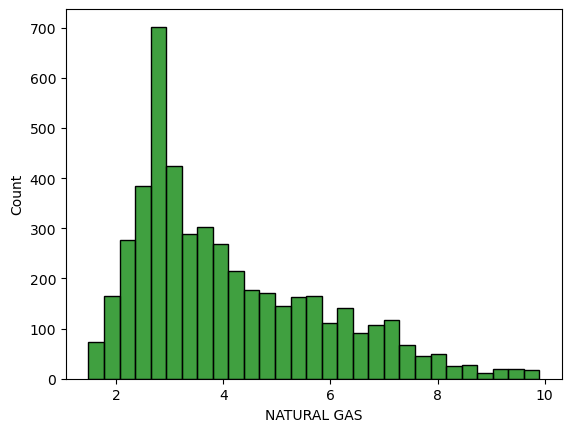

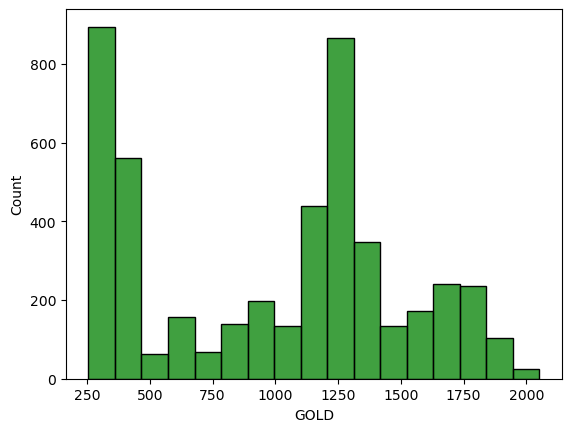

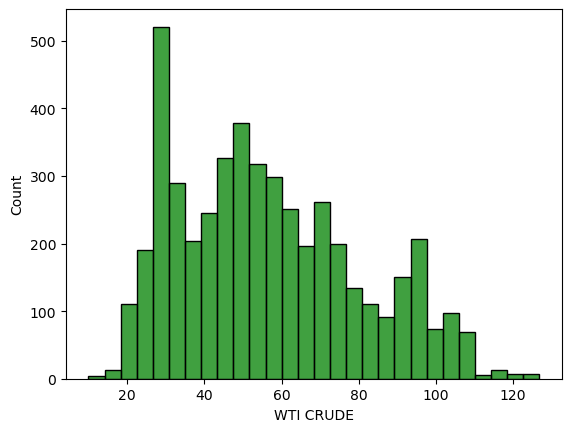

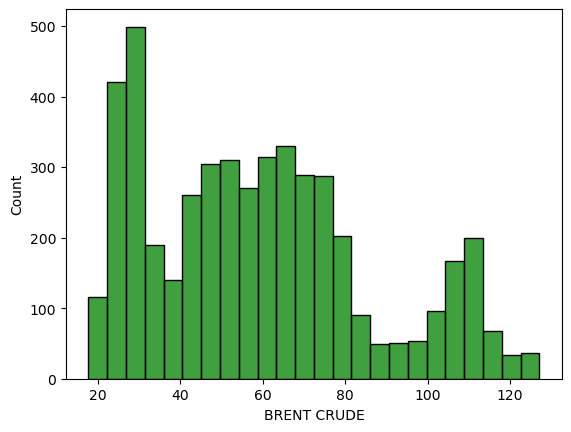

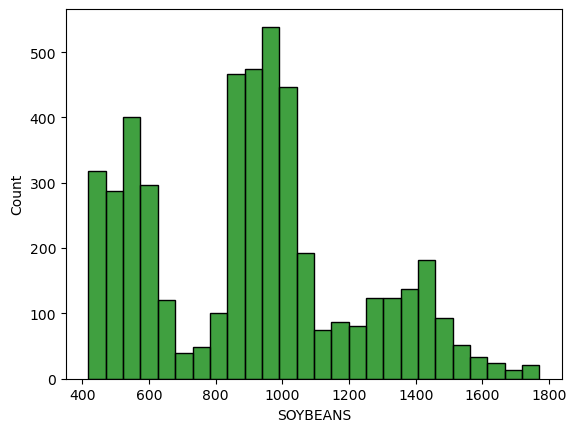

...

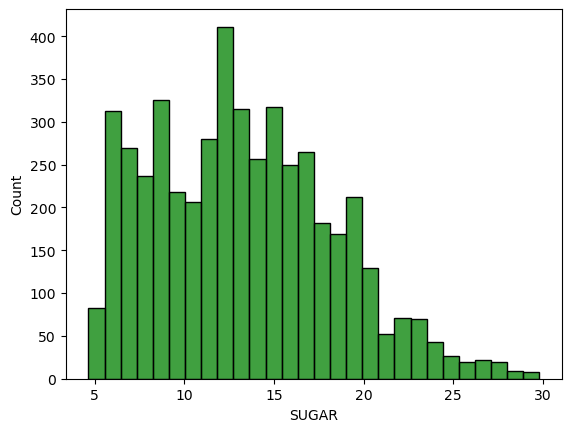

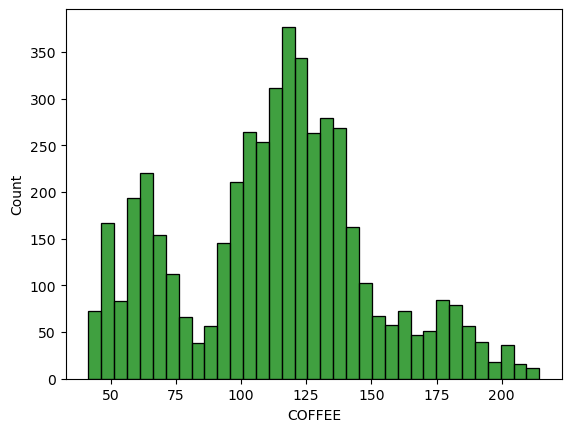

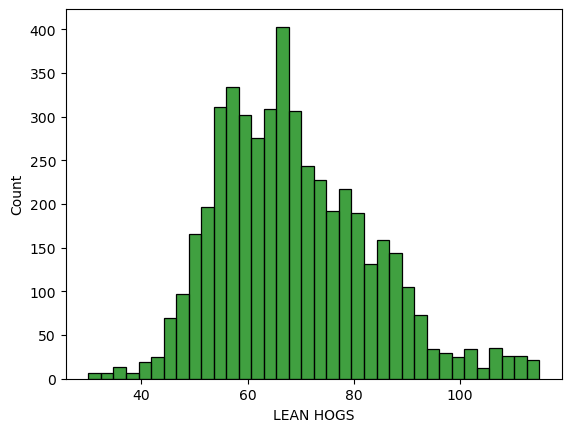

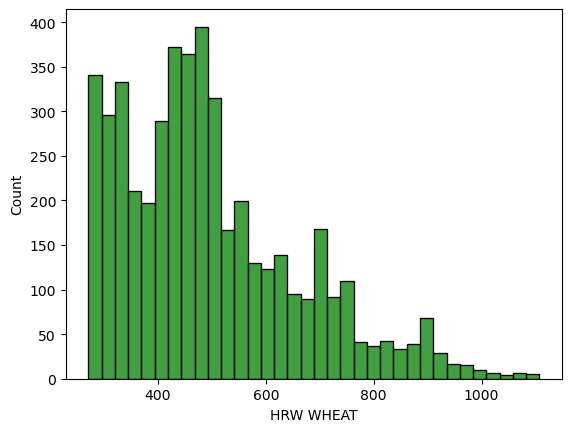

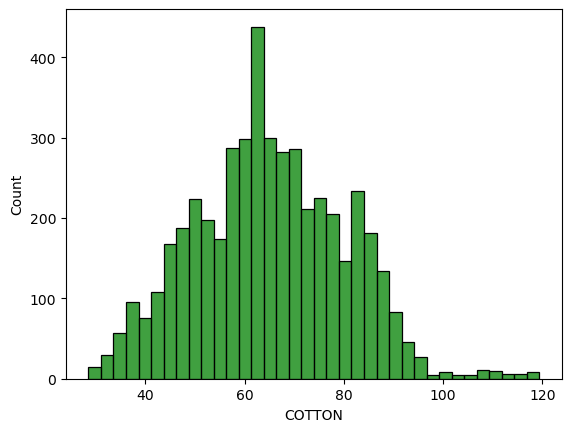

In [80]:
for i in df.columns:
    if df[i].dtypes != "object":
        sns.histplot(x =df[i] ,color='green')
        plt.show()

# Kde plot

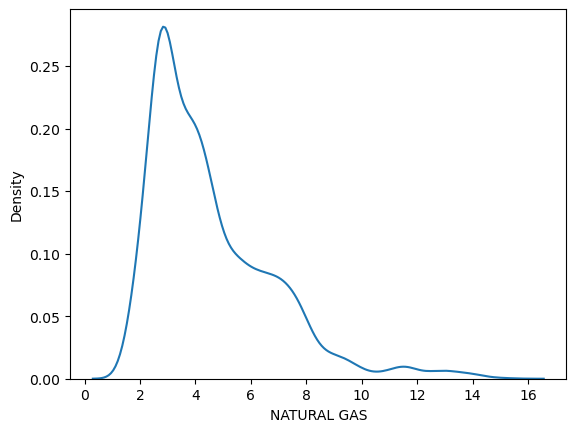

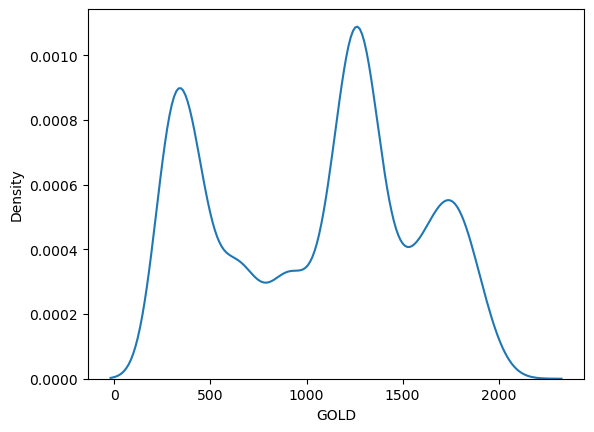

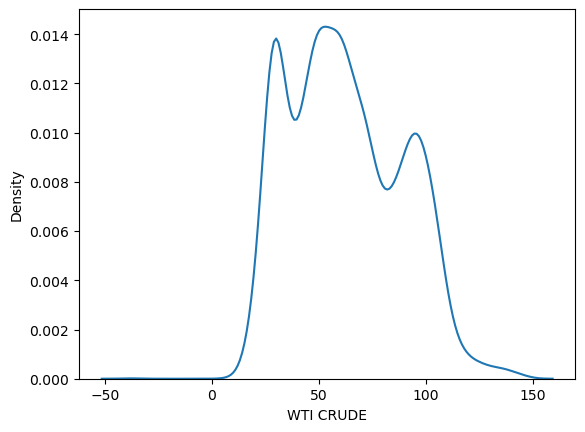

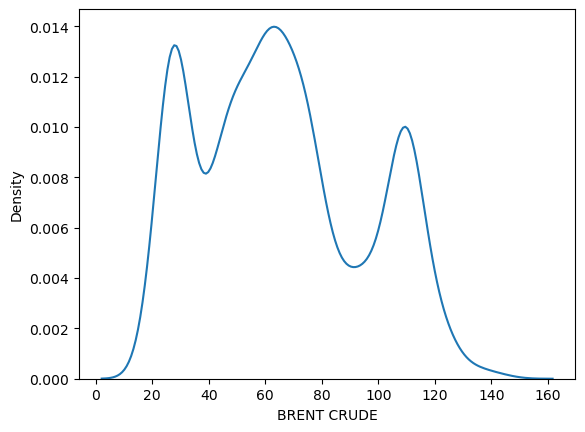

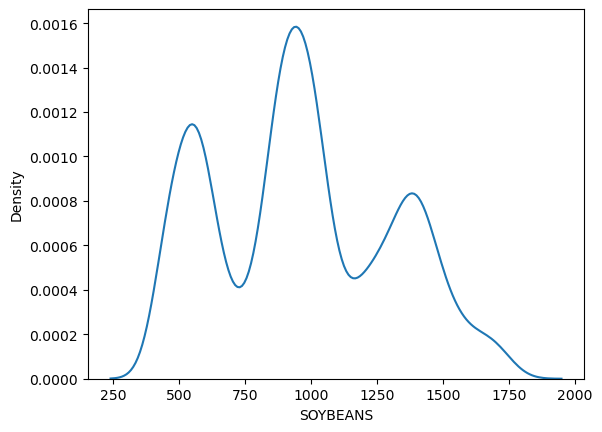

...

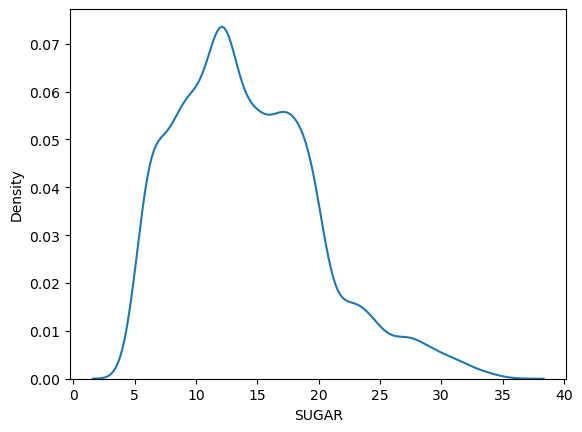

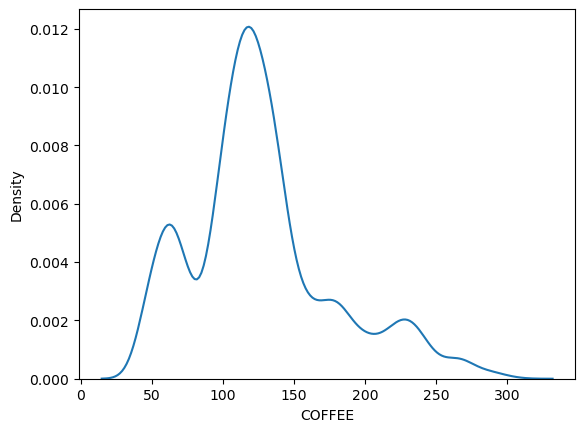

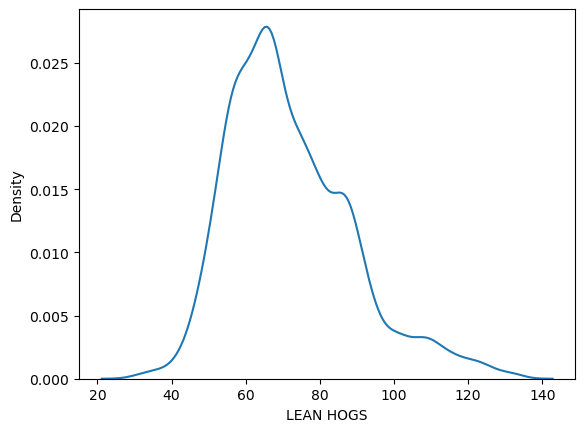

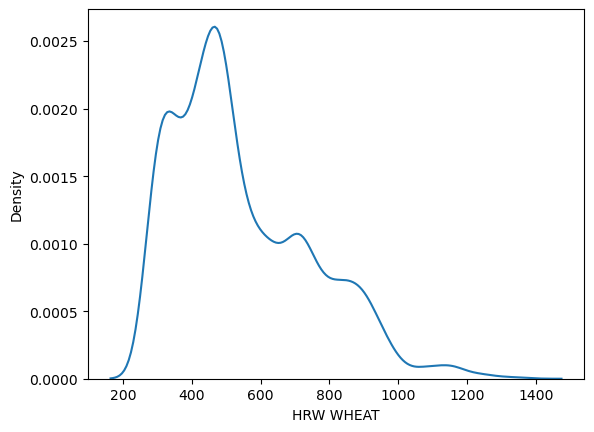

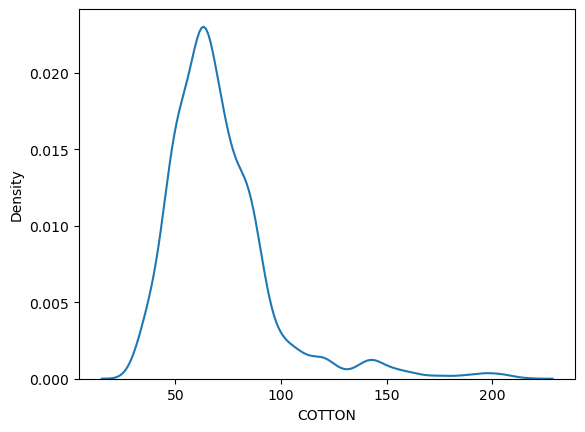

In [32]:
for i in df.columns:
    if df[i].dtypes != "object":
        sns.kdeplot(x =df[i] )
        plt.show()

# Boxplot

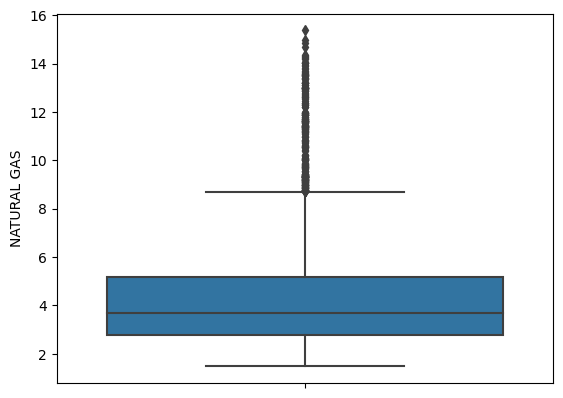

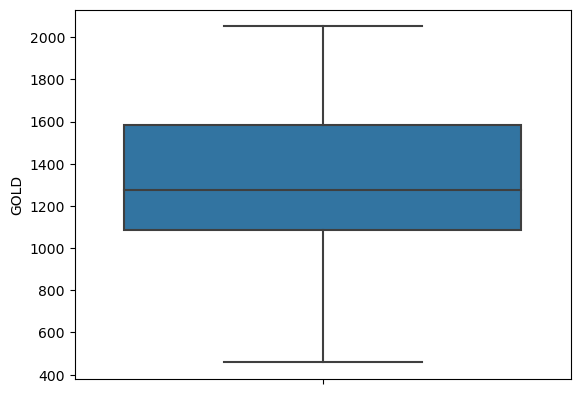

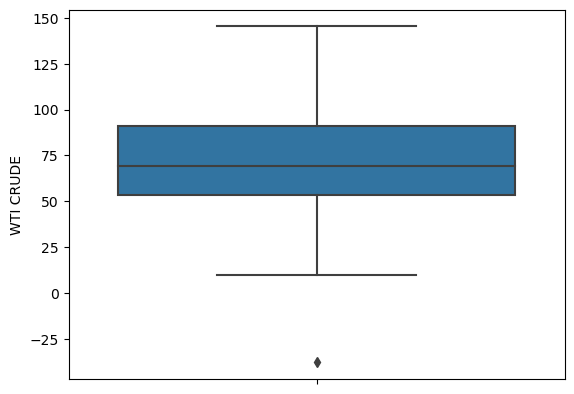

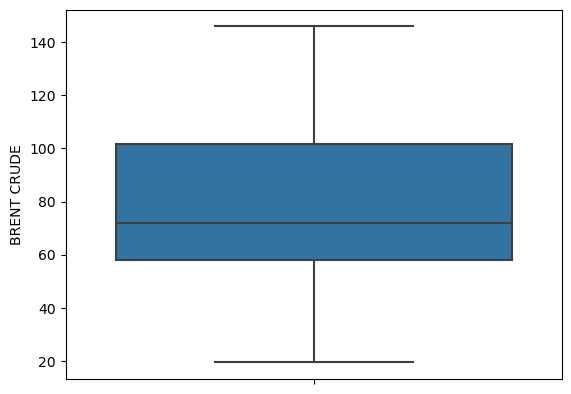

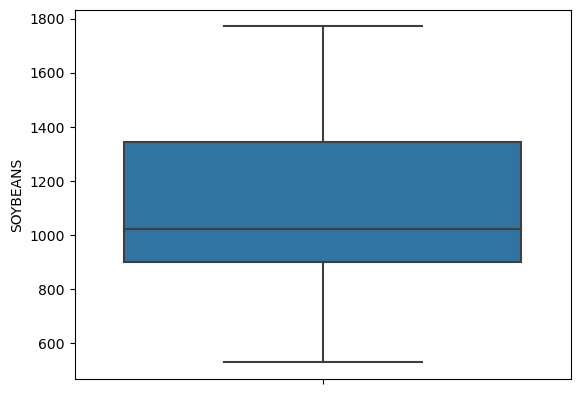

...

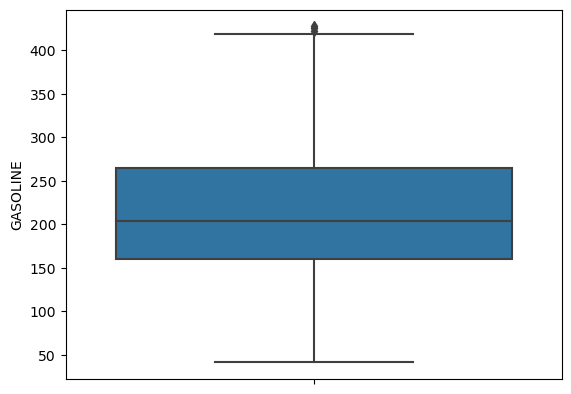

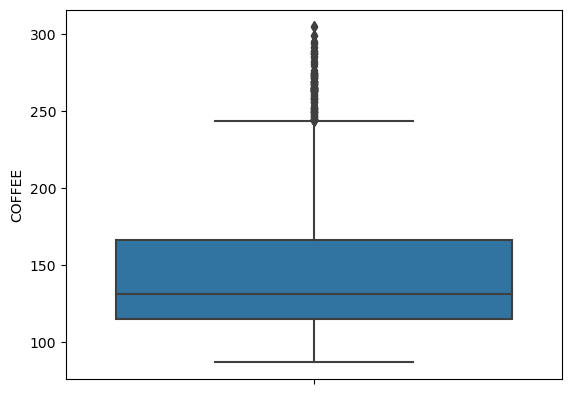

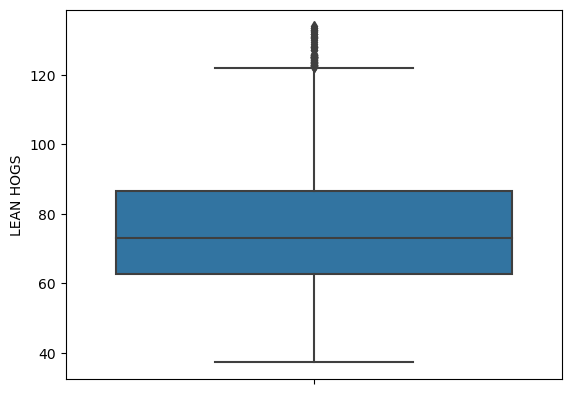

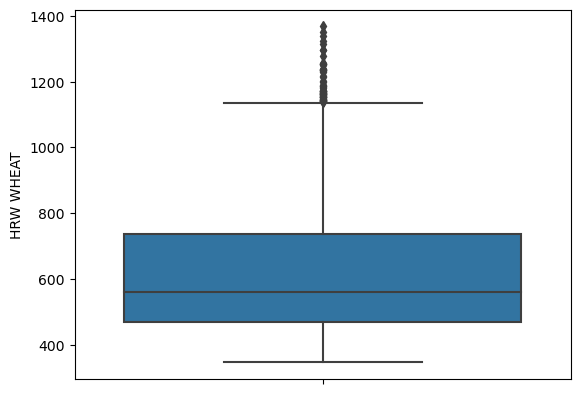

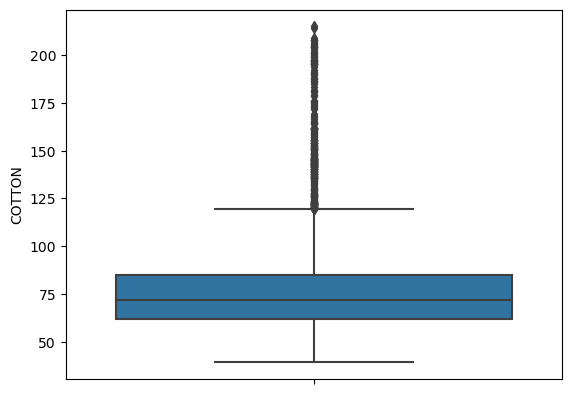

In [12]:
for i in df.columns:
    if df[i].dtypes != "object":
        sns.boxplot(y = df[i])
        plt.show();

# Violin plot

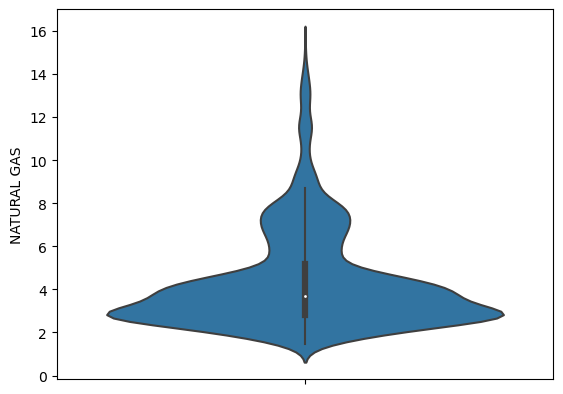

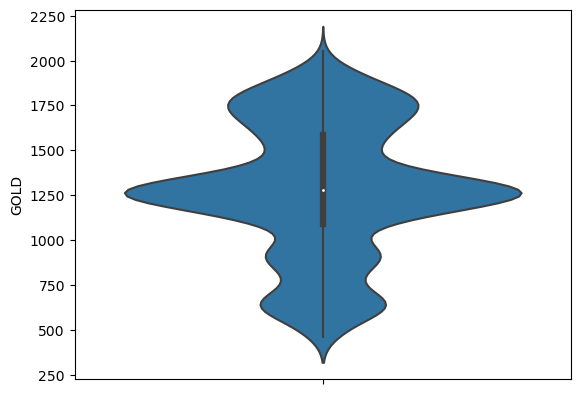

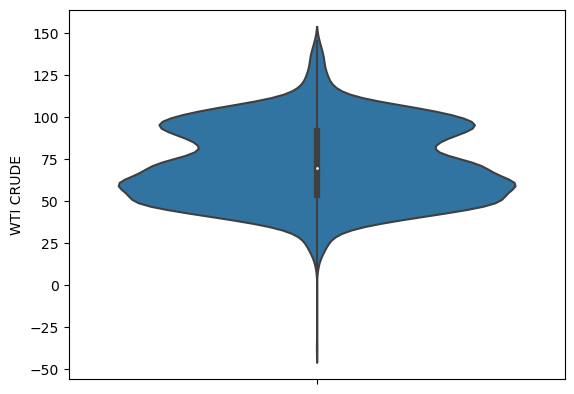

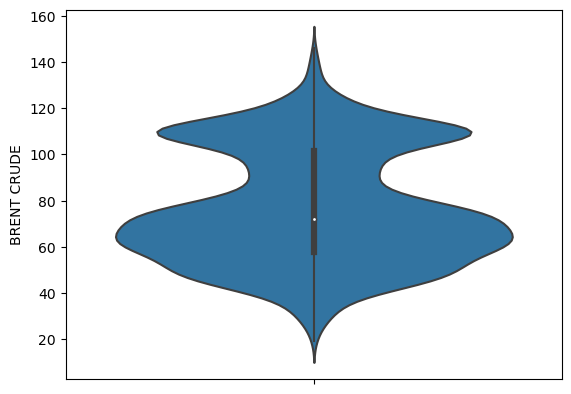

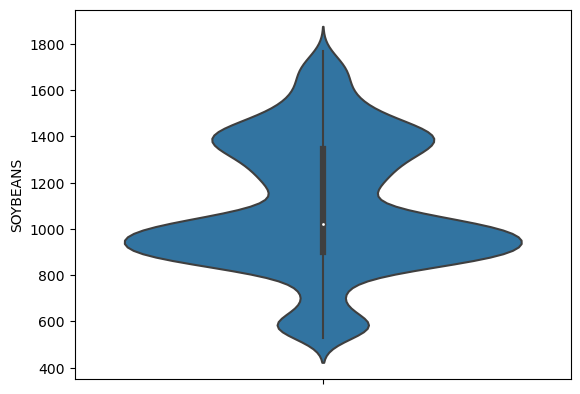

...

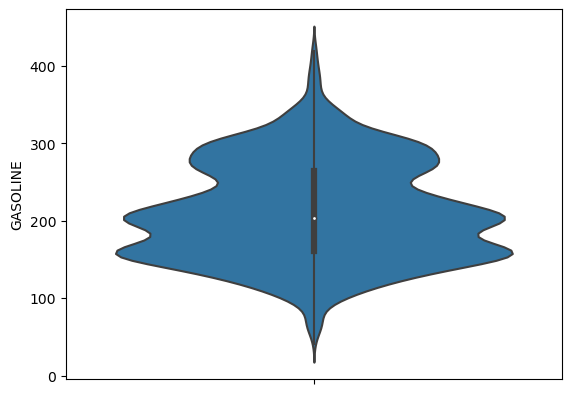

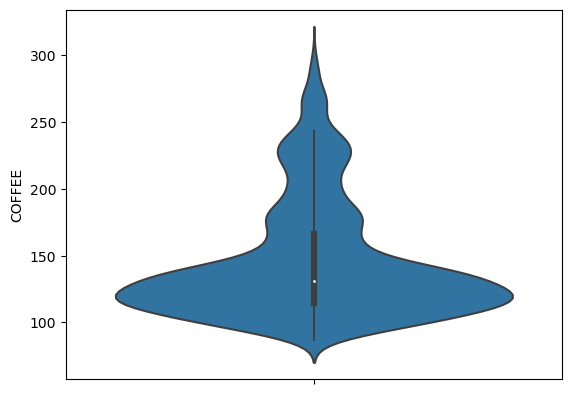

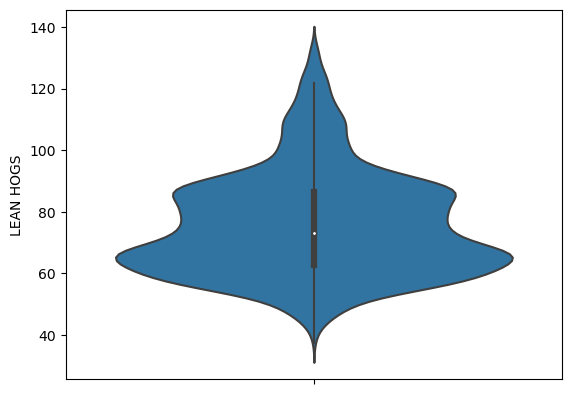

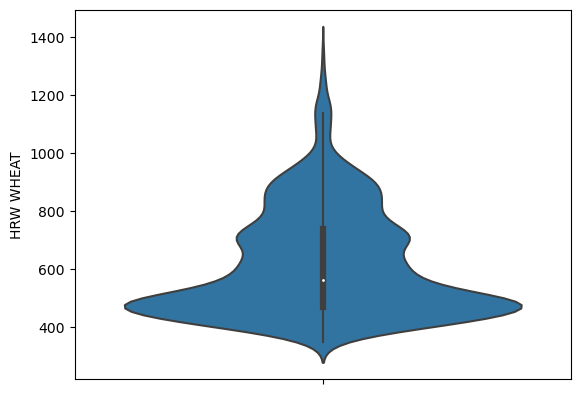

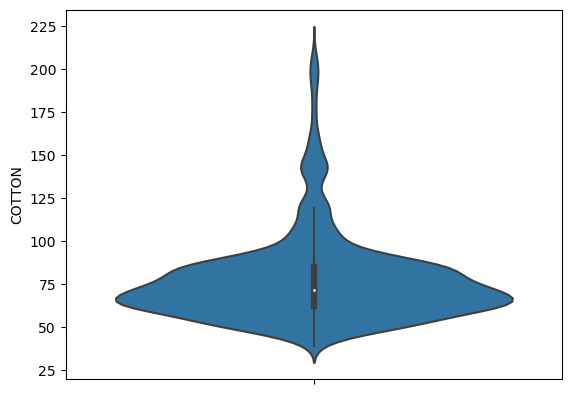

In [13]:
for i in df.columns:
    if df[i].dtype!='object':
        sns.violinplot(y=df[i],GOLD='blue')
        plt.show()

# MULTI VARIATE ANALYSIS

# Line plot

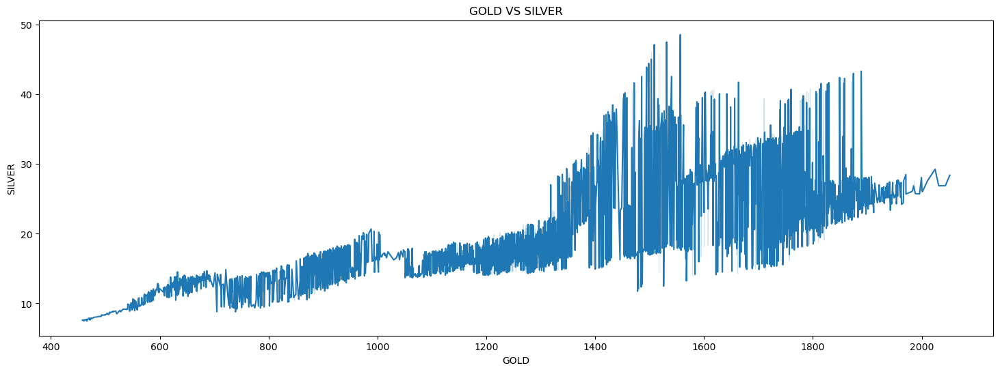

In [14]:
plt.figure(figsize=(18,6))
sns.lineplot('GOLD','SILVER',data=df)
plt.title('GOLD VS SILVER')
plt.show()

# Pair plot

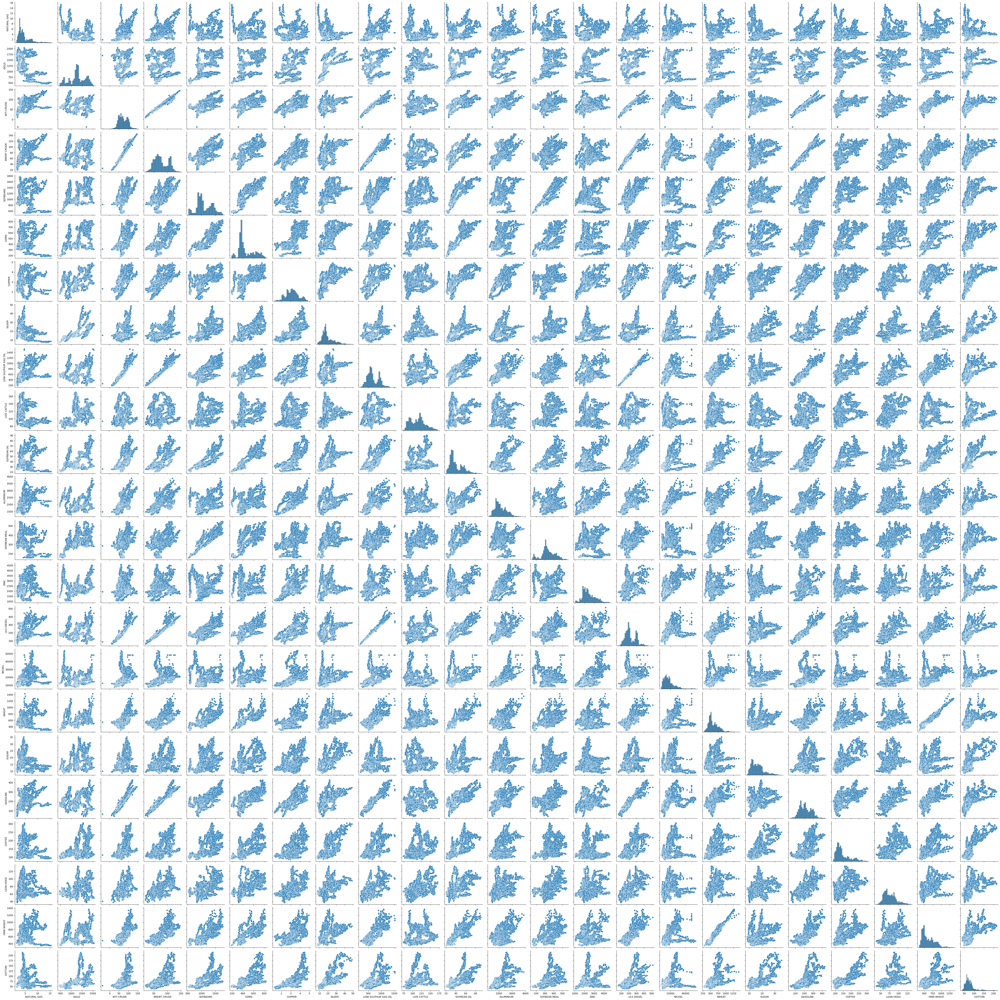

In [15]:
sns.pairplot(data=df)
plt.show()

# Treating outliers

In [33]:
def outlier_limit(col):
    Q3, Q1 = np.nanpercentile (col, [75,25])
    IQR = Q3 - Q1
    UL = Q3+1.5*IQR
    LL = Q1-1.5*Q1
    return UL, LL
for column in df.columns:
    if df[column].dtype != "object":
        UL, LL = outlier_limit(df[column])
        df[column] = np.where((df[column]>UL) | (df[column]<LL),np.nan,df[column])

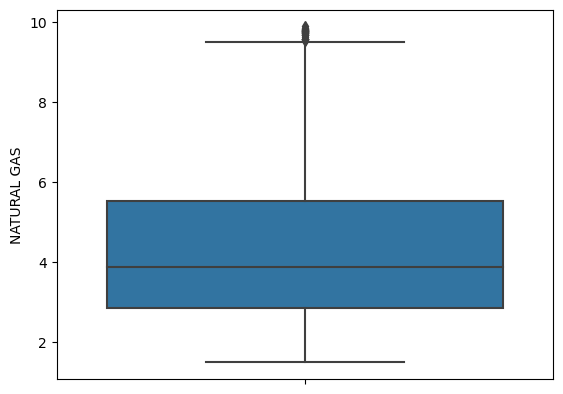

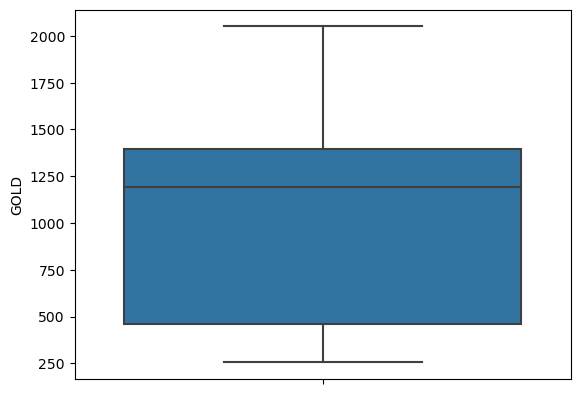

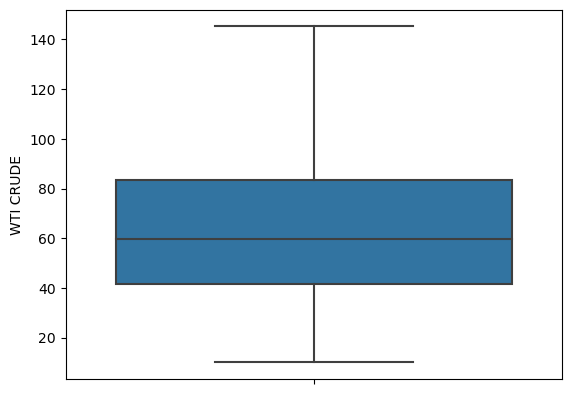

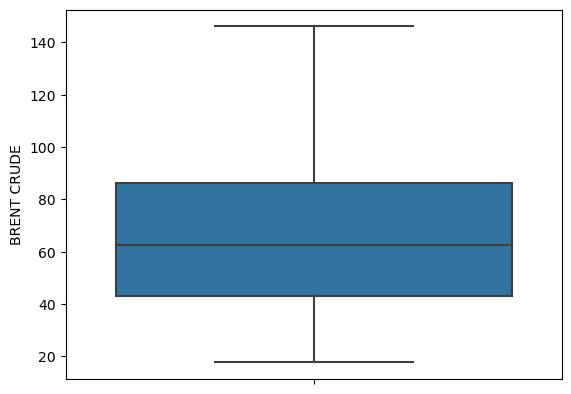

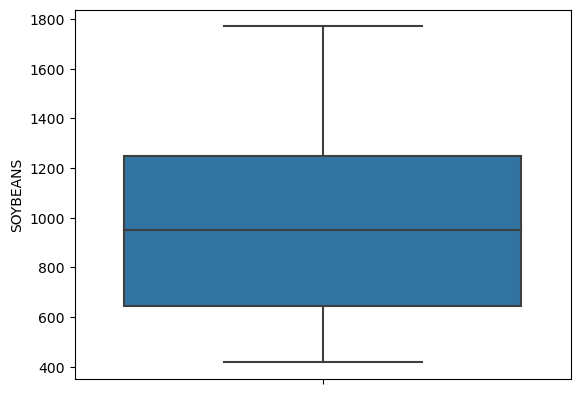

...

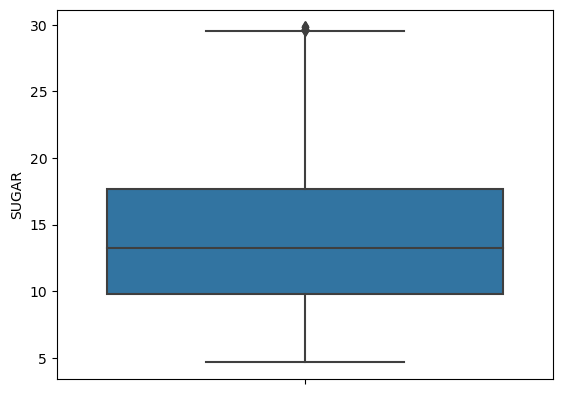

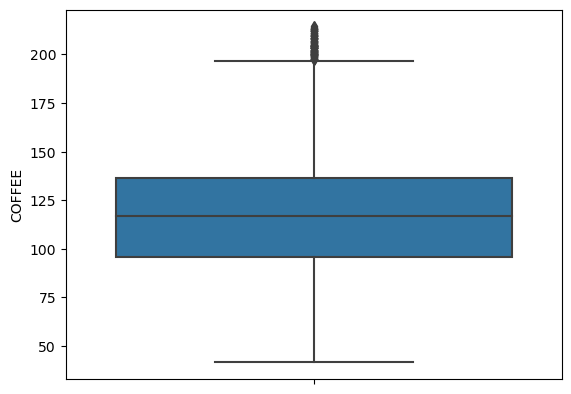

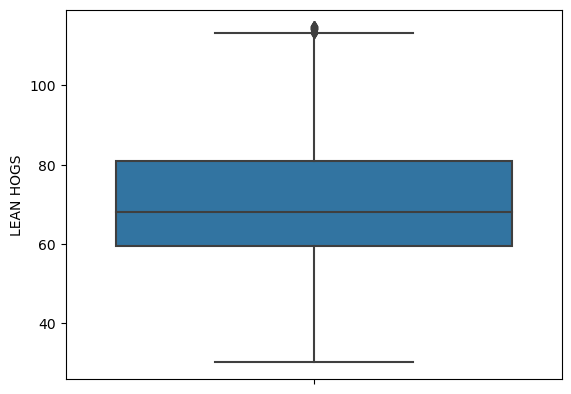

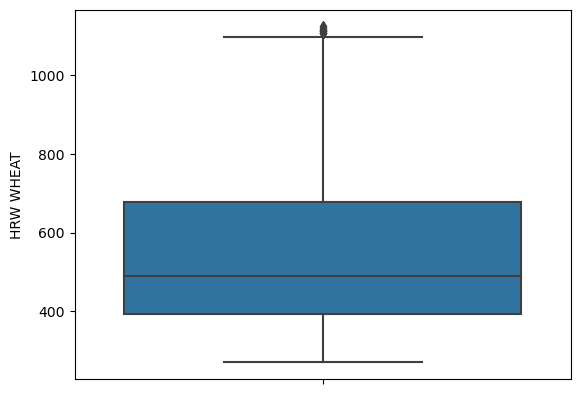

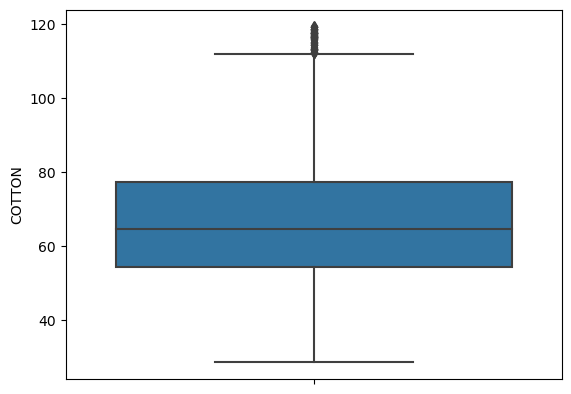

In [34]:
for i in df.columns:
    if df[i].dtype!='object':
        sns.boxplot(y=df[i])
        plt.show();

In [35]:
df.isnull().sum()

NATURAL GAS            172
GOLD                     0
WTI CRUDE                1
BRENT CRUDE              0
SOYBEANS                 0
CORN                     0
COPPER                   0
SILVER                  74
LOW SULPHUR GAS OIL     17
LIVE CATTLE              0
SOYBEAN OIL            138
ALUMINIUM               59
SOYBEAN MEAL             0
ZINC                     2
ULS DIESEL              15
NICKEL                 273
WHEAT                   81
SUGAR                   82
COFFEE                 527
LEAN HOGS              130
HRW WHEAT               66
COTTON                 300
dtype: int64

In [36]:
df.dropna(inplace=True)

In [37]:
df.shape

(4777, 22)

# Checking the correlation with the target "GOLD"

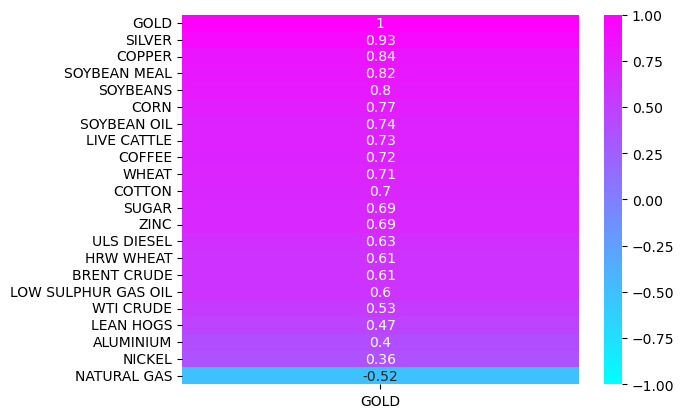

In [38]:
sns.heatmap(df.corr()[["GOLD"]].sort_values(by="GOLD", ascending=False), vmin=-1, vmax=1, annot=True,cmap="cool");

# Lets take only the columns with good correlation with the target

In [39]:
x=df[['SILVER',"SOYBEANS","CORN","COTTON","LIVE CATTLE","COFFEE"]].values

In [40]:
y=df[["GOLD"]].values

# Feature scaling

In [41]:
rs = RobustScaler()

In [42]:
x = rs.fit_transform(x)

In [43]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=0)

# Model building

In [44]:
models = {
    "LinearRegression": LinearRegression(),
    "Ridge":Ridge(),
    "LinearSVR":LinearSVR(),
    "DecisionTreeRegressor":DecisionTreeRegressor(),
    "GradientBoostingRegressor":GradientBoostingRegressor(),
    "AdaBoostRegressor":AdaBoostRegressor(),
    "RandomForestRegressor":RandomForestRegressor()
}

In [45]:
for name, model in models.items():
    scores = cross_val_score(model, x,y, scoring="neg_mean_squared_error",cv=10,n_jobs=-1)
    print("cross validation model : {}".format(name))
    rmse = np.sqrt(-scores)
    rmse_average = np.mean(rmse)
    print("AVERAGE RMSE: ",rmse_average)
    print("*"*100)
    

cross validation model : LinearRegression
AVERAGE RMSE:  207.9290671015787
****************************************************************************************************
cross validation model : Ridge
AVERAGE RMSE:  207.9808067501769
****************************************************************************************************
cross validation model : LinearSVR
AVERAGE RMSE:  235.97574928707976
****************************************************************************************************
cross validation model : DecisionTreeRegressor
AVERAGE RMSE:  236.5429453124556
****************************************************************************************************
cross validation model : GradientBoostingRegressor
AVERAGE RMSE:  177.03405127322577
****************************************************************************************************
cross validation model : AdaBoostRegressor
AVERAGE RMSE:  190.50194196613623
*********************************************

# Selecting Random GRADIENT BOOSTING REGRESSOR as it is having best metrics

In [64]:
model = GradientBoostingRegressor()

In [65]:
model.fit(x_train, y_train)

GradientBoostingRegressor()

In [66]:
y_pred = model.predict(x)

In [67]:
OUTPUT = pd.DataFrame(zip(y,y_pred), columns=("ACTUAL", "PREDICTION"), dtype=float)

In [68]:
OUTPUT.head()

,ACTUAL,PREDICTION
0,283.7,303.678816
1,282.1,295.507009
2,282.4,288.643009
3,282.9,288.643009
4,282.7,288.643009


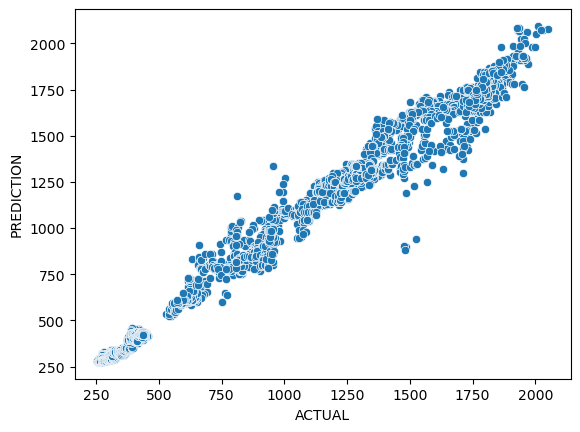

In [69]:
sns.scatterplot(data=OUTPUT, x="ACTUAL", y="PREDICTION");

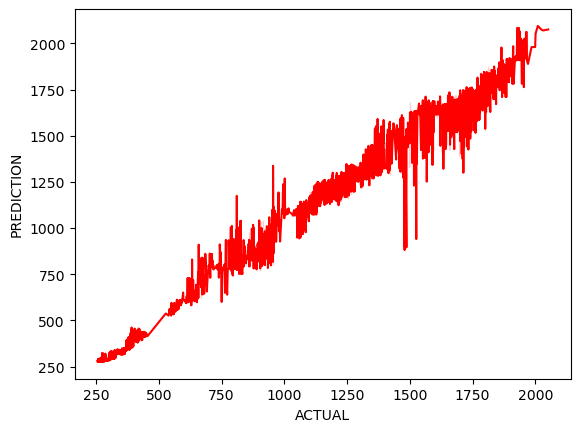

In [71]:
sns.lineplot(data=OUTPUT, x="ACTUAL", y="PREDICTION",color='red');

In [74]:
model.score(x,y)*100

98.75605064947895